In [1]:
from PIL import ImageFilter, Image
import pytesseract
import IPython.display 
from  pdf2image import convert_from_path
from os import listdir
import numpy as np
from matplotlib import pyplot as plt
import cv2

In [2]:
path = 'exploration_data/'
dpi = 450
first_page = 1
last_page = 2 # value None means that the last page will be the last
thread_count = 1
size = None

In [3]:
# store each pdf images from the pdfs directory
dir_images = []
# TODO(leommiranda): should I use cropbox instead of mediabox?
for pdf_path in listdir(path):
    try:
        # TODO(leommiranda): substituir este erro por um conversor de pdf "normal" para texto
        text = dadasd
    except:
        pdf_images = convert_from_path(pdf_path=path+pdf_path, 
                                       dpi=dpi, 
                                       first_page=first_page, 
                                       last_page=last_page, 
                                       thread_count=thread_count, 
                                       size=size)
        dir_images.append(pdf_images)

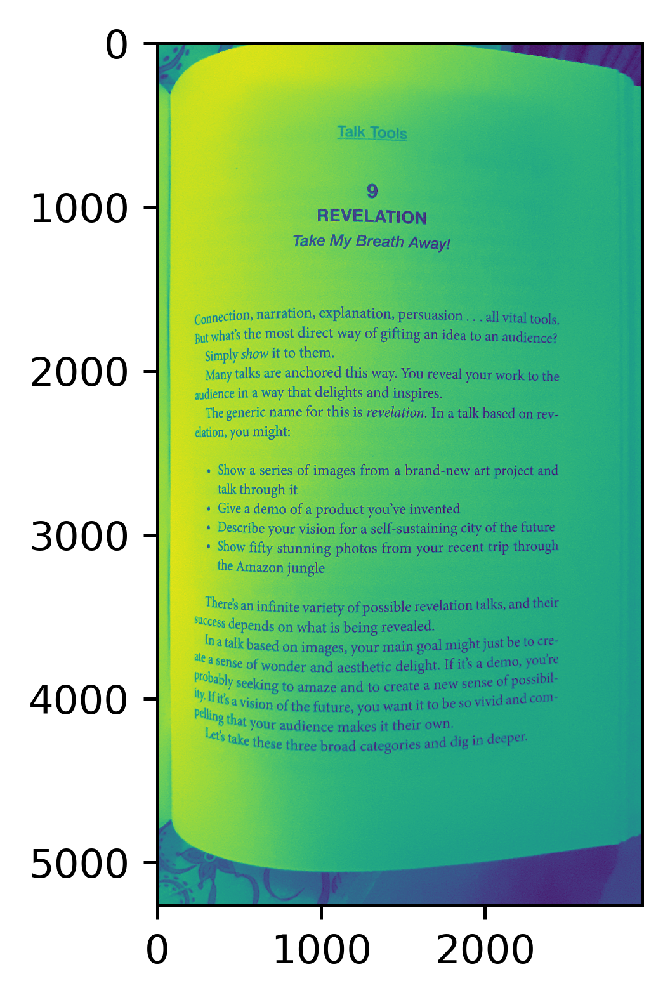

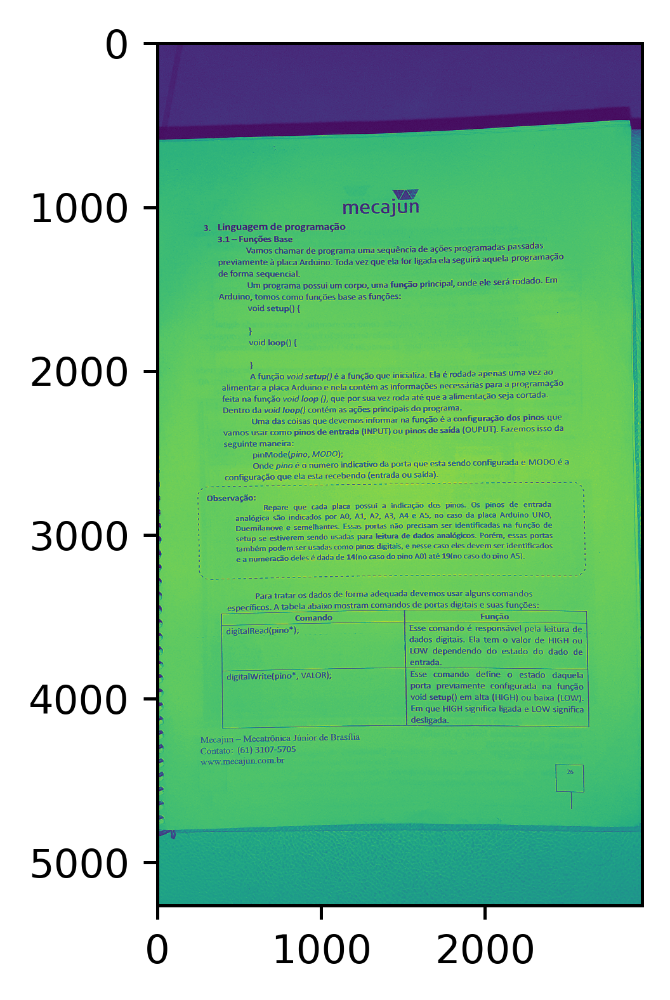

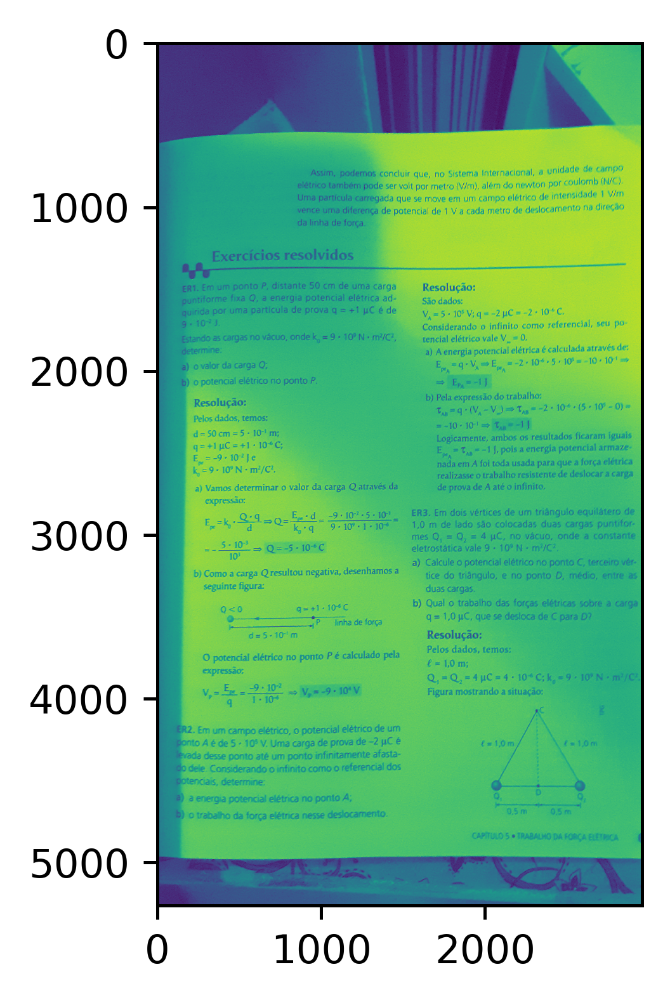

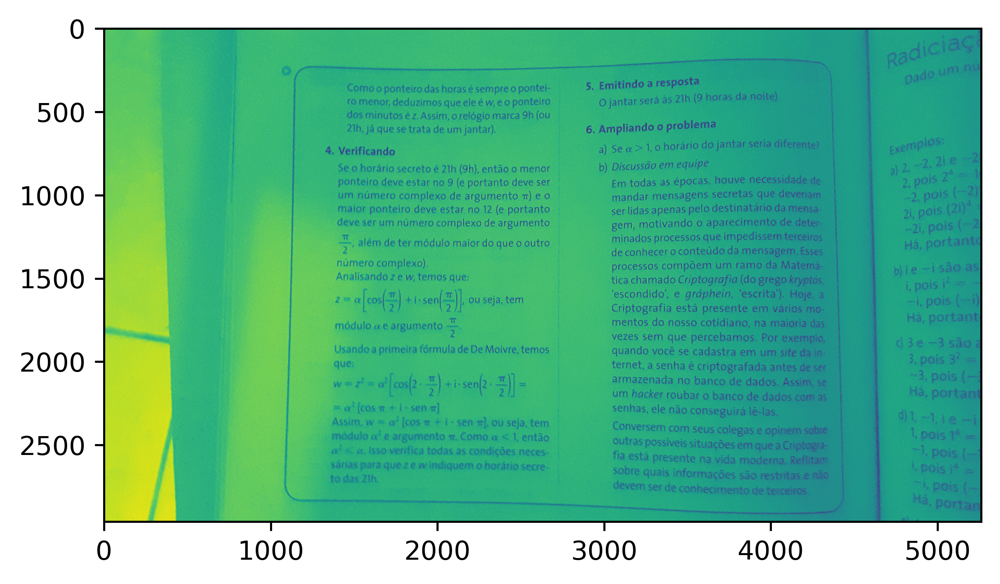

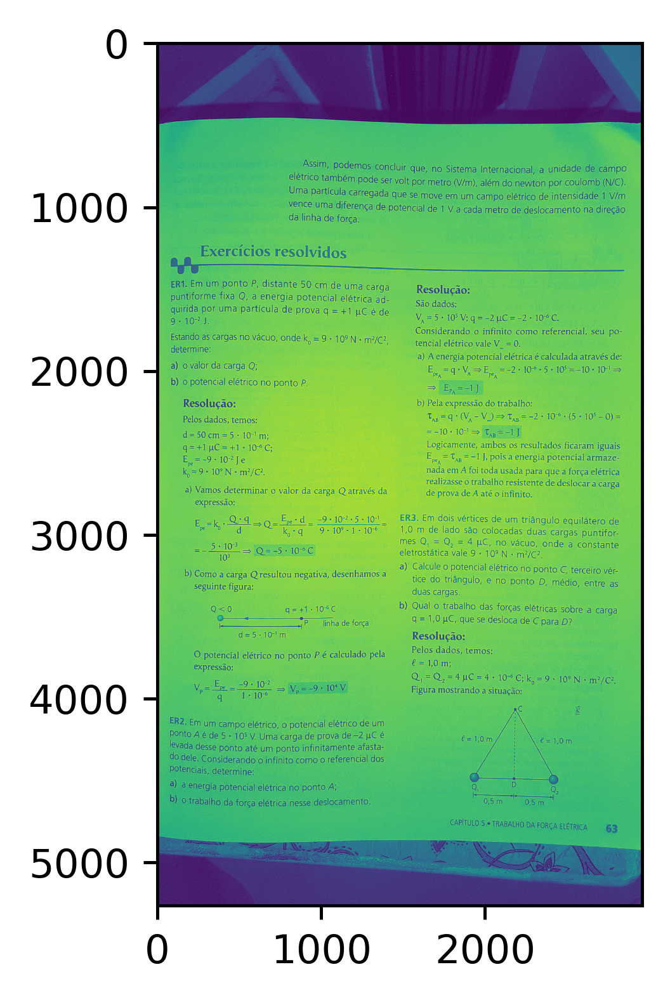

...

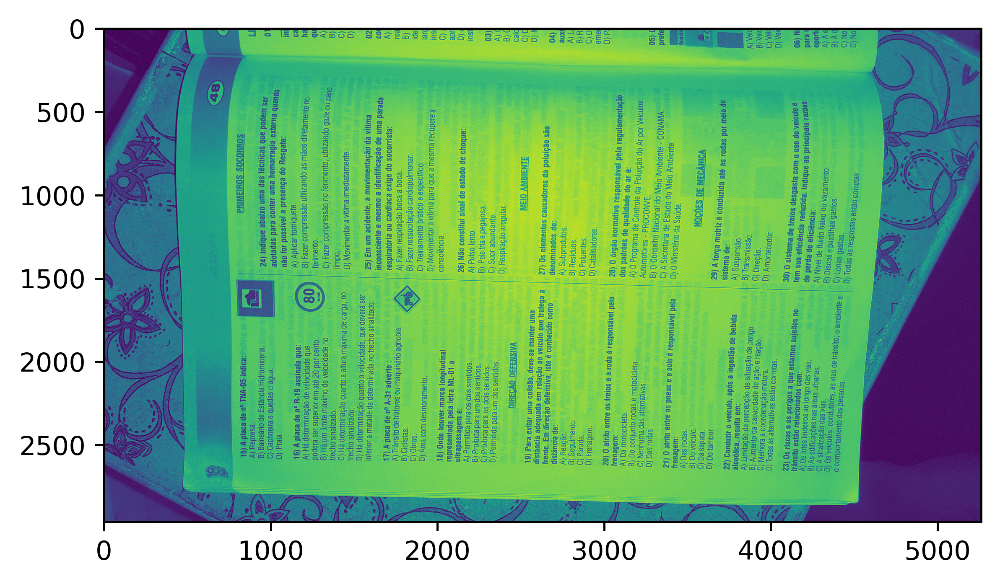

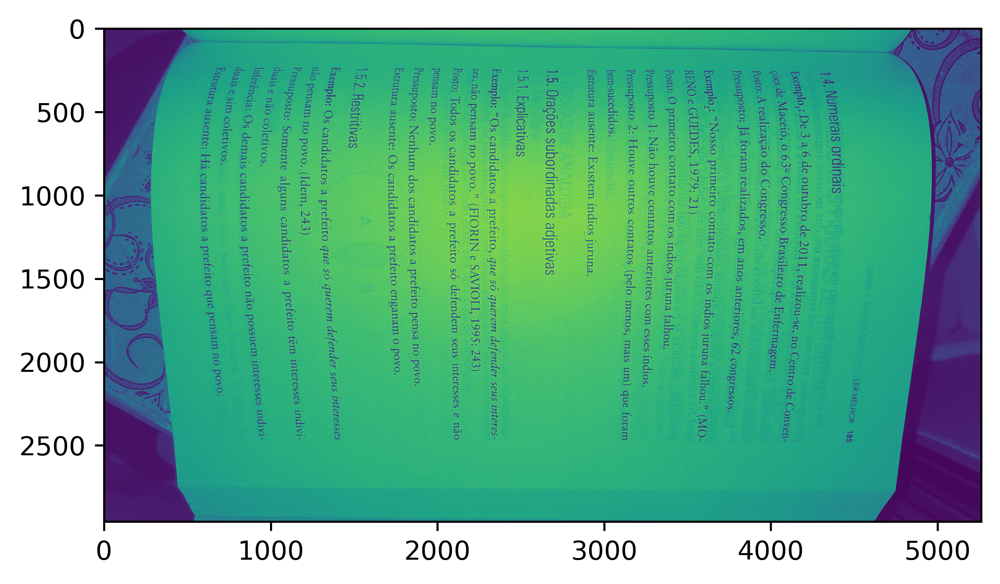

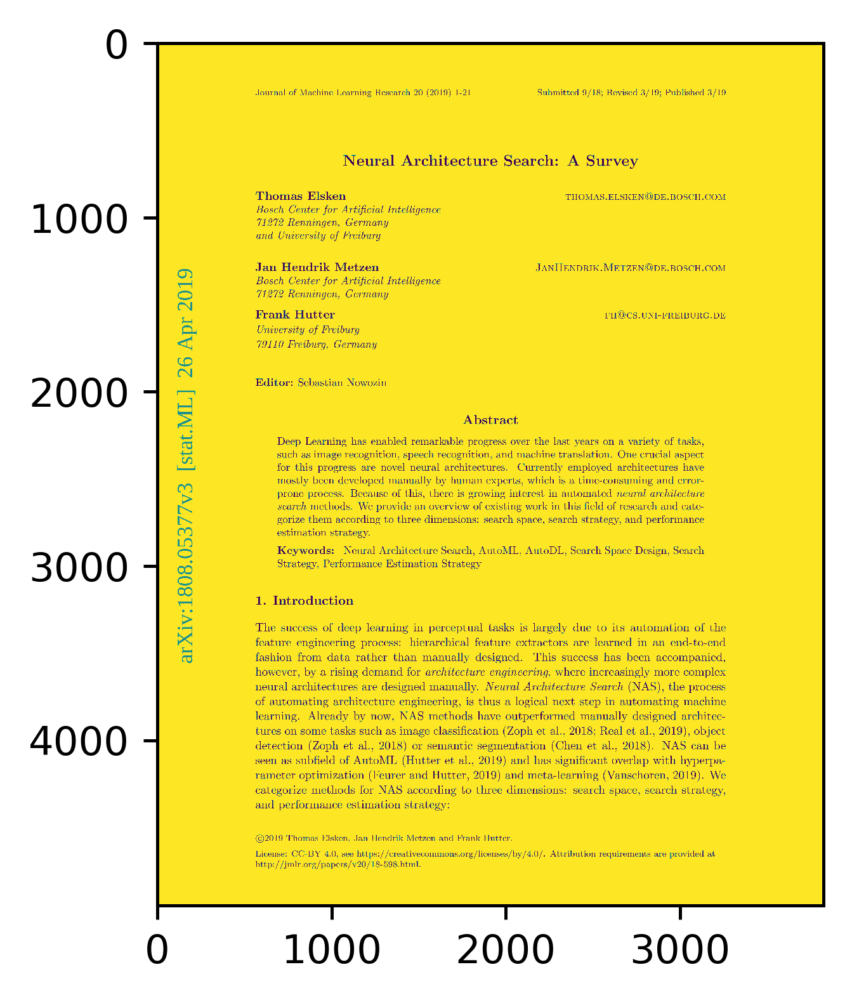

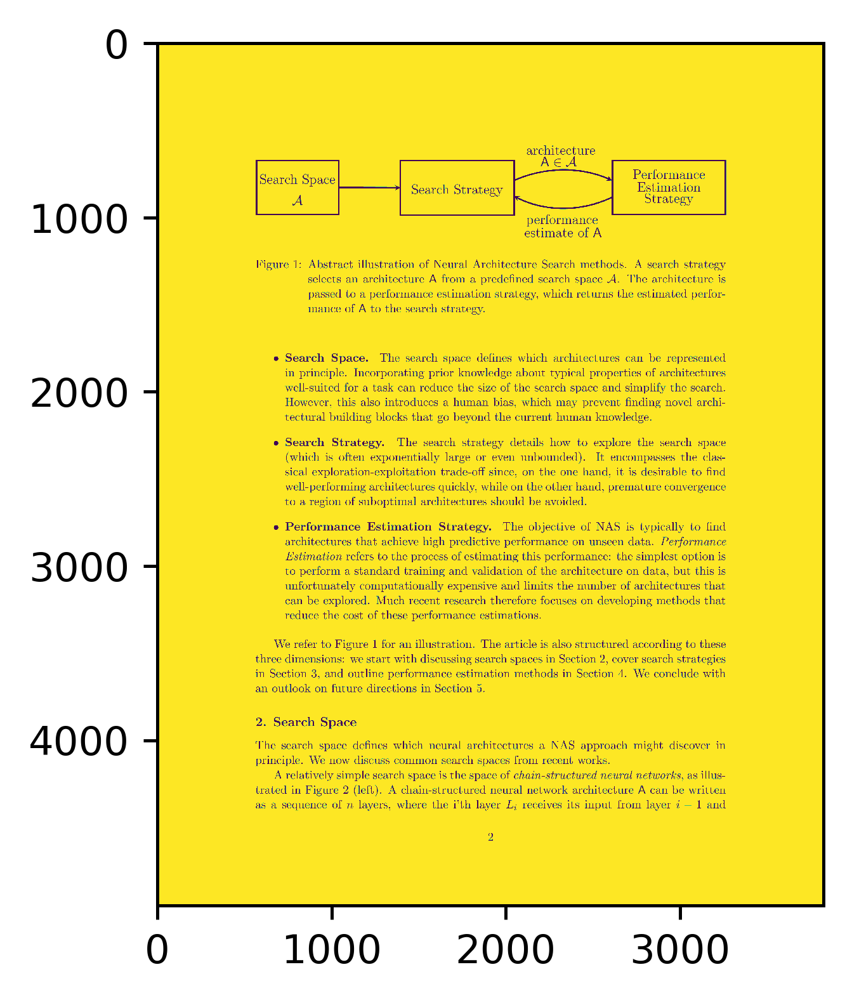

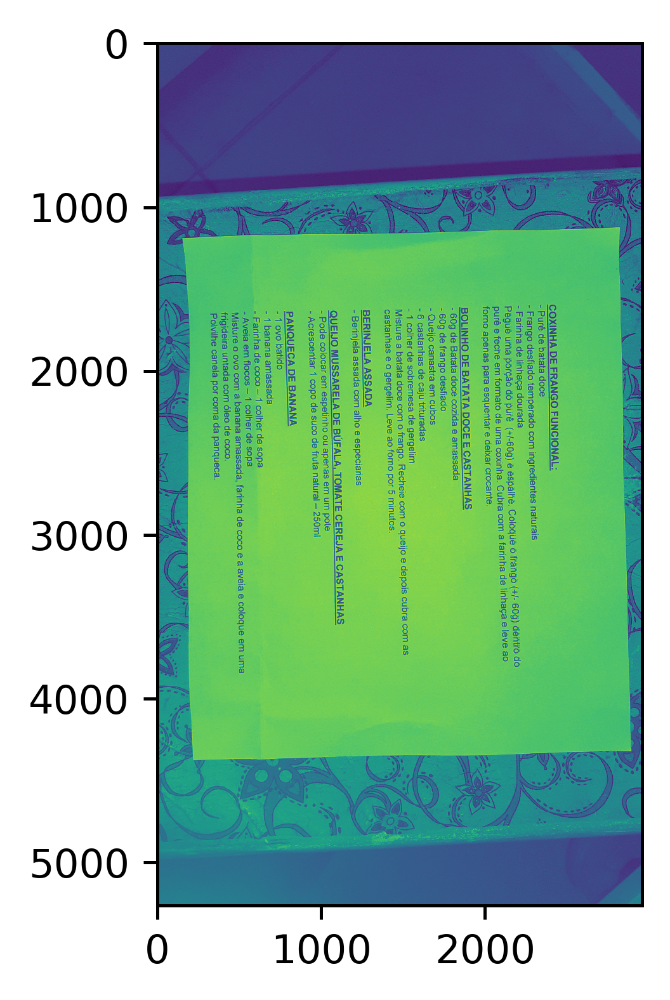

In [4]:
# Visualize gray images
for pdf_images in dir_images:
    for pdf_img in pdf_images:
        pdf_img = np.array(pdf_img.convert('RGB'))
        pdf_img = cv2.cvtColor(pdf_img, cv2.COLOR_RGB2GRAY)
        plt.figure(dpi=dpi)
        plt.imshow(pdf_img)

In [ ]:
# Visualize gray images with bilateralFilter() and adaptiveThreshold()
for pdf_images in dir_images:
    for pdf_img in pdf_images:
        pdf_img = np.array(pdf_img.convert('RGB'))
        pdf_img = cv2.cvtColor(pdf_img, cv2.COLOR_RGB2GRAY)
        # makes adaptiveThreshold run faster and remove noise
        pdf_img = cv2.bilateralFilter(pdf_img, 17, 75, 75)
        # deals better with ilumination issues than the OTSU threshold algorithm 
            # which is the tesseract default algorithm
        # If ilumination isn't a big deal, remeber to comment out bilateralFilter() and adaptiveThreshold()
        pdf_img = cv2.adaptiveThreshold(pdf_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)
        # close operation, it seems unuseful when tesseract is applied, but I'm not sure
        # pdf_img = cv2.morphologyEx(pdf_img, cv2.MORPH_CLOSE, (21,21))
        plt.figure(dpi=dpi)
        plt.imshow(pdf_img)

In [ ]:
# Visualize gray images with OTSU threshold, which doesn't deal quite well with ilumination
    # here the OpenCV implementation of OTSU is being applied, which is probably not the same imp. of tesseract 
for pdf_images in dir_images:
    for pdf_img in pdf_images:
        pdf_img = np.array(pdf_img.convert('RGB'))
        pdf_img = cv2.cvtColor(pdf_img, cv2.COLOR_RGB2GRAY)
        pdf_img = cv2.threshold(pdf_img, 0, 135, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        # close operation, it seems unuseful when tesseract is applied, but I'm not sure
        pdf_img = cv2.morphologyEx(pdf_img, cv2.MORPH_CLOSE, (21,21))
        plt.figure(dpi=dpi)
        plt.imshow(pdf_img)